# Neuro 240 Final Project - Effortful Retrieval-Based Weighting (ERBW)



## Pretrained Discriminator and Generator

In [ ]:
from __future__ import print_function
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt

cudnn.benchmark = True

#set manual seed to a constant get a consistent output
manualSeed = random.randint(1, 10000)
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

#loading the dataset
dataset = dset.MNIST(root='./data', download=True,
                       transform=transforms.Compose([
                           transforms.Resize(28),
                           transforms.ToTensor(),
                           transforms.Normalize((0.5,), (0.5,)),
                       ]))
#number of channels in image(since the image is grayscale the number of channels are 1)
nc=1

dataloader = torch.utils.data.DataLoader(dataset, batch_size=64,
                                         shuffle=True, num_workers=2)

#checking the availability of cuda devices
device = 'cpu'

# number of gpu's available
ngpu = 1
# input noise dimension
nz = 100
# number of generator filters
ngf = 64
#number of discriminator filters
ndf = 64

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    def __init__(self, ngpu, nc=1, nz=100, ngf=64):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(    ngf,      nc, kernel_size=1, stride=1, padding=2, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
        return output

netG = Generator(ngpu).to(device)
netG.apply(weights_init)
netG.load_state_dict(torch.load('weights/netG_epoch_99.pth', map_location=torch.device('cpu')))
print(netG)

class Discriminator(nn.Module):
    def __init__(self, ngpu, nc=1, ndf=64):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, 1, 4, 2, 1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
        return output.view(-1, 1).squeeze(1)

netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
netD.load_state_dict(torch.load('weights/netD_epoch_99.pth', map_location=torch.device('cpu')))
print(netD)

criterion = nn.BCELoss()

# setup optimizer
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))

fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1.0
fake_label = 0.0

niter = 25

# Commented out IPython magic to ensure Python compatibility.
for epoch in range(niter):
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        # train with real
        netD.zero_grad()
        real_cpu = data[0].to(device)
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)

        output = netD(real_cpu)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # train with fake
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach())
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label) 
        output = netD(fake)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
                  % (epoch, niter, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        if i % 100 == 0:
            vutils.save_image(real_cpu,'output/real_samples.png' ,normalize=True)
            fake = netG(fixed_noise)
            vutils.save_image(fake.detach(),'output/fake_samples_epoch_%03d.png' % (epoch), normalize=True)        
    torch.save(netG.state_dict(), 'weights/netG_epoch_%d.pth' % (epoch))
    torch.save(netD.state_dict(), 'weights/netD_epoch_%d.pth' % (epoch))

num_gpu = 1 if torch.cuda.is_available() else 0

# load the models

D = Discriminator(ngpu=1).eval()
G = Generator(ngpu=1).eval()

# load weights
D.load_state_dict(torch.load('weights/netD_epoch_99.pth', map_location=torch.device('cpu')))
G.load_state_dict(torch.load('weights/netG_epoch_99.pth', map_location=torch.device('cpu')))
if torch.cuda.is_available():
    D = D.cuda()
    G = G.cuda()

batch_size = 25
latent_size = 100

fixed_noise = torch.randn(batch_size, latent_size, 1, 1)
if torch.cuda.is_available():
    fixed_noise = fixed_noise.cuda()
fake_images = G(fixed_noise)


# z = torch.randn(batch_size, latent_size).cuda()
# z = Variable(z)
# fake_images = G(z)

fake_images_np = fake_images.cpu().detach().numpy()
fake_images_np = fake_images_np.reshape(fake_images_np.shape[0], 28, 28)
R, C = 5, 5
for i in range(batch_size):
    plt.subplot(R, C, i + 1)
    plt.imshow(fake_images_np[i], cmap='gray')
plt.show()

## Distill


Epoch 1/200
Control: TPR=0.641, FPR=0.438, Precision=0.594, F1=0.617, MeanD(G)=0.447, Time=0.7s
Single-Step: TPR=0.688, FPR=0.438, Precision=0.611, F1=0.647, MeanD(G)=0.436, Time=0.9s
Dynamic-Step: TPR=0.688, FPR=0.469, Precision=0.595, F1=0.638, MeanD(G)=0.497, Time=0.7s
ERBW: TPR=0.906, FPR=0.938, Precision=0.492, F1=0.637, MeanD(G)=0.918, Time=1.2s

Epoch 2/200
Control: TPR=0.812, FPR=0.156, Precision=0.839, F1=0.825, MeanD(G)=0.194, Time=0.8s
Single-Step: TPR=0.812, FPR=0.438, Precision=0.650, F1=0.722, MeanD(G)=0.433, Time=0.7s
Dynamic-Step: TPR=0.922, FPR=0.703, Precision=0.567, F1=0.702, MeanD(G)=0.693, Time=0.6s
ERBW: TPR=0.953, FPR=0.828, Precision=0.535, F1=0.685, MeanD(G)=0.820, Time=1.1s

Epoch 3/200
Control: TPR=0.828, FPR=0.266, Precision=0.757, F1=0.791, MeanD(G)=0.292, Time=0.6s
Single-Step: TPR=0.828, FPR=0.219, Precision=0.791, F1=0.809, MeanD(G)=0.236, Time=0.6s
Dynamic-Step: TPR=0.969, FPR=0.516, Precision=0.653, F1=0.780, MeanD(G)=0.511, Time=0.6s
ERBW: TPR=0.969,

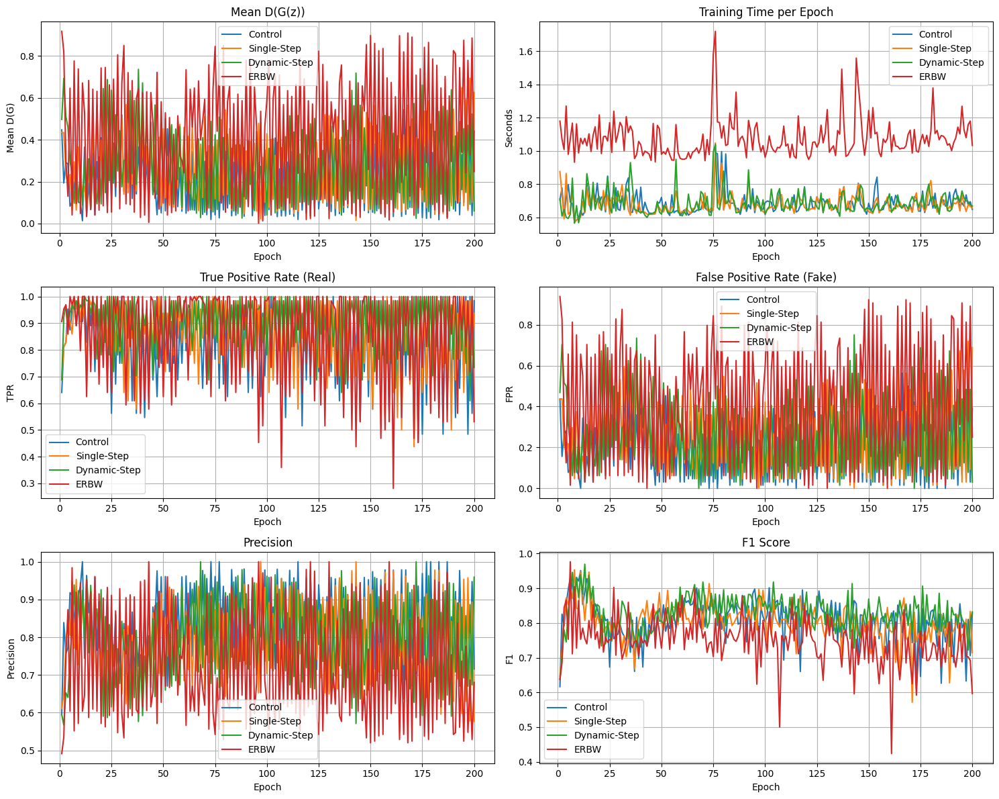

In [17]:
#!/usr/bin/env python3
"""
distill_real_vs_fake_schemes.py

Distillation of pretrained DCGAN Generator & Discriminator on MNIST.
Implements four sampling schemes (Control, Single-Step, Dynamic-Step, ERBW),
starts from pretrained weights, alternates D and G training per epoch,
tracks TPR, FPR, Precision, F1 on real vs. fake batches, mean D(G(z)), and training time,
saves model weights after each epoch as {D/G}_distill_{sampling_strategy}_{epoch}.pth,
and at end plots all six metrics.
"""
import os
import random
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.backends.cudnn as cudnn
import torchvision.datasets as dset
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np

from collections import OrderedDict
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import precision_score, f1_score
from scipy.stats import kurtosis
import pandas as pd

# ------------------- Config & Hyperparameters -------------------

# Choose GPU if available, else CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
cudnn.benchmark = True  # enable optimized cudnn kernels

# Fix random seeds for reproducibility
random.seed(21)
torch.manual_seed(21)

# DCGAN architecture constants
nz, ngf, ndf, nc = 100, 64, 64, 1  # latent dim, gen/disc filters, channels

# Directory to save weight snapshots
weights_dir = './weights'
os.makedirs(weights_dir, exist_ok=True)

# Distillation training schedule
epochs     = 200   # total epochs
D_steps    = 2     # discriminator updates per epoch
G_steps    = 1     # generator updates per epoch
batch_size = 64    # batch size

# Parameters for dynamic-step and ERBW sampling
target_kurtosis = 1.0

# --------------------- Model Definitions ---------------------

class Generator(nn.Module):
    """DCGAN Generator (transposed-conv network)"""
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            # input: (batch, nz, 1, 1) → (batch, ngf*8, 4, 4)
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8), nn.ReLU(True),
            # → (batch, ngf*4, 8, 8)
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4), nn.ReLU(True),
            # → (batch, ngf*2, 16, 16)
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2), nn.ReLU(True),
            # → (batch, ngf, 32, 32)
            nn.ConvTranspose2d(ngf*2, ngf,   4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),   nn.ReLU(True),
            # output conv → (batch, nc, 32, 32)
            nn.ConvTranspose2d(ngf,   nc,    1, 1, 0, bias=False),
            nn.Tanh()  # map outputs to [-1, 1]
        )

    def forward(self, z):
        return self.main(z)


class Discriminator(nn.Module):
    """DCGAN Discriminator (conv network)"""
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            # input: (batch, nc, 32, 32) → (batch, ndf, 16, 16)
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, True),
            # → (batch, ndf*2, 8, 8)
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, True),
            # → (batch, ndf*4, 4, 4)
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, True),
            # → (batch, 1, 1, 1)
            nn.Conv2d(ndf*4, 1,      4, 1, 0, bias=False),
            nn.Sigmoid()  # output probability in [0, 1]
        )

    def forward(self, x):
        return self.main(x).view(-1)  # flatten to (batch,)


# --------------------- Load pretrained -----------------------

# Instantiate and load pretrained weights
netG0 = Generator().to(device)
netG0.load_state_dict(torch.load(
    os.path.join(weights_dir, 'netG_epoch_99.pth'),
    map_location=device
))
netD0 = Discriminator().to(device)
netD0.load_state_dict(torch.load(
    os.path.join(weights_dir, 'netD_epoch_99.pth'),
    map_location=device
))

# ----------------------- DataLoader --------------------------

# Real MNIST images, normalized to [-1,1], resized to 32×32
transform = transforms.Compose([
    transforms.Resize(32),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])
real_ds     = dset.MNIST('./data', train=True, download=True, transform=transform)
real_loader = torch.utils.data.DataLoader(real_ds, batch_size=batch_size, shuffle=True)

# Raw images (unnormalized) for ERBW similarity buffer
raw_transform = transforms.Compose([
    transforms.Resize(32),
    transforms.ToTensor()
])
raw_ds   = dset.MNIST('./data', train=True, download=True, transform=raw_transform)
raw_imgs = torch.stack([raw_ds[i][0] for i in range(len(raw_ds))]).to(device)

# ------------------ Sampling Schemes ------------------------

def train_control(G, D):
    """
    Control: standard DCGAN step
    - one D update on real vs. fake
    - one G update to fool D
    """
    optD = torch.optim.Adam(D.parameters(), lr=2e-4, betas=(0.5, 0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5, 0.999))
    crit = nn.BCELoss()

    # fetch real batch and generate fake batch
    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz, 1, 1, device=device))

    # D loss: log D(real) + log(1 - D(fake))
    lossD = crit(D(real), torch.ones(batch_size, device=device)) + \
            crit(D(fake.detach()), torch.zeros(batch_size, device=device))
    optD.zero_grad(); lossD.backward(); optD.step()

    # G loss: log D(G(z))
    fake2 = G(torch.randn(batch_size, nz, 1, 1, device=device))
    lossG = crit(D(fake2), torch.ones(batch_size, device=device))
    optG.zero_grad(); lossG.backward(); optG.step()

    return G, D


def train_single_step(G, D, real_ratio=0.7):
    """
    Single-Step: D is trained on a fixed real:fake ratio each update.
    """
    optD = torch.optim.Adam(D.parameters(), lr=2e-4, betas=(0.5, 0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5, 0.999))
    crit = nn.BCELoss(reduction='none')

    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz, 1, 1, device=device))
    outR, outF = D(real), D(fake.detach())

    # weight real vs. fake in D loss
    lossD = (crit(outR, torch.ones_like(outR)) * real_ratio).mean() + \
            (crit(outF, torch.zeros_like(outF)) * (1 - real_ratio)).mean()
    optD.zero_grad(); lossD.backward(); optD.step()

    fake2 = G(torch.randn(batch_size, nz, 1, 1, device=device))
    lossG = crit(D(fake2), torch.ones_like(outR)).mean()
    optG.zero_grad(); lossG.backward(); optG.step()

    return G, D


def train_dynamic_step(G, D, target_k=target_kurtosis):
    """
    Dynamic-Step: weigh real vs. fake based on kurtosis of D(fake)
    to maintain distributional characteristic.
    """
    optD = torch.optim.Adam(D.parameters(), lr=2e-4, betas=(0.5, 0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5, 0.999))
    crit = nn.BCELoss(reduction='none')

    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz, 1, 1, device=device))
    outR, outF = D(real), D(fake.detach())

    # compute kurtosis and mix accordingly
    k     = kurtosis(outF.detach().cpu().numpy())
    ratio = np.clip(0.5 + 0.5 * abs(k - target_k), 0.2, 0.8)

    lossD = (crit(outR, torch.ones_like(outR)) * ratio).mean() + \
            (crit(outF, torch.zeros_like(outF)) * (1 - ratio)).mean()
    optD.zero_grad(); lossD.backward(); optD.step()

    fake2 = G(torch.randn(batch_size, nz, 1, 1, device=device))
    lossG = nn.BCELoss()(D(fake2), torch.ones_like(outR))
    optG.zero_grad(); lossG.backward(); optG.step()

    return G, D


class ERBWBuffer:
    """
    Effortful Retrieval-Based Weighting (ERBW) buffer:
    - stores flattened real images and timestamps of last retrieval
    - assigns higher weights to generated samples aligned with under-retrieved real samples
    """
    def __init__(self, data):
        self.data = data.view(len(data), -1).cpu().numpy()
        self.ts   = np.zeros(len(data))

    def update(self, fake):
        flat = fake.detach().view(len(fake), -1).cpu().numpy()
        idx  = np.argmax(cosine_similarity(flat, self.data), axis=1)
        self.ts[idx] = self.ts.max() + 1

    def weights(self, fake):
        flat = fake.detach().view(len(fake), -1).cpu().numpy()
        idx  = np.argmax(cosine_similarity(flat, self.data), axis=1)
        w    = F.softmax(torch.from_numpy(self.ts[idx]).float(), dim=0)
        return w.to(fake.device)


def train_erbw(G, D, buf):
    """
    ERBW sampling scheme:
    - update timestamp buffer with current fake batch
    - weight D(fake) loss by sample weights from buffer
    """
    optD = torch.optim.Adam(D.parameters(), lr=5e-4, betas=(0.5, 0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5, 0.999))
    crit = nn.BCELoss(reduction='none')

    real = next(real_iter)[0].to(device)
    fake = G(torch.randn(batch_size, nz, 1, 1, device=device))

    buf.update(fake)
    w = buf.weights(fake)

    outR    = D(real)
    outF_det = D(fake.detach())
    # weight real half and fake by ERBW weights
    lossD = crit(outR, torch.ones_like(outR)).mean()*0.5 + \
            (crit(outF_det, torch.zeros_like(outF_det)) * w).mean()
    optD.zero_grad(); lossD.backward(); optD.step()

    fake2 = G(torch.randn(batch_size, nz, 1, 1, device=device))
    lossG = nn.BCELoss()(D(fake2), torch.ones_like(outR))
    optG.zero_grad(); lossG.backward(); optG.step()

    return G, D

# ------------------- Main Distill Loop -------------------

# initialize ERBW buffer
buffer = ERBWBuffer(raw_imgs)

# map scheme name to function
schemes = OrderedDict([
    ('Control',      train_control),
    ('Single-Step',  train_single_step),
    ('Dynamic-Step', train_dynamic_step),
    ('ERBW',         lambda G, D: train_erbw(G, D, buffer))
])

# create fresh models for each scheme from pretrained
models = {}
for name in schemes:
    G = Generator().to(device)
    D = Discriminator().to(device)
    G.load_state_dict(netG0.state_dict())
    D.load_state_dict(netD0.state_dict())
    models[name] = {'G': G, 'D': D}

# metrics storage (add precision & F1)
metrics = {
    name: {
      'tpr':[], 'fpr':[], 'precision':[], 'f1':[],
      'mean_fake':[], 'time':[]
    }
    for name in schemes
}
epochs_list = range(1, epochs+1)

for ep in epochs_list:
    print(f"\nEpoch {ep}/{epochs}")
    # reset real-data iterator each epoch
    real_iter = iter(real_loader)

    for name, fn in schemes.items():
        G, D = models[name]['G'], models[name]['D']

        # time D+G update
        start = time.time()
        G, D = fn(G, D)
        elapsed = time.time() - start

        # evaluate on one real batch and one fake batch
        realb = next(real_iter)[0].to(device)
        fakeb = G(torch.randn(batch_size, nz, 1, 1, device=device))
        with torch.no_grad():
            r = D(realb)
            f = D(fakeb)

        # ground-truth labels for metrics
        y_true = np.concatenate([np.ones(batch_size), np.zeros(batch_size)])
        y_pred = np.concatenate([(r>0.5).cpu().numpy(), (f>0.5).cpu().numpy()])

        # compute metrics
        tpr = float((r>0.5).float().mean().item())
        fpr = float((f>0.5).float().mean().item())
        mf  = float(f.mean().item())
        prec = precision_score(y_true, y_pred, zero_division=0)
        f1   = f1_score(y_true, y_pred, zero_division=0)

        # record
        metrics[name]['mean_fake'].append(mf)
        metrics[name]['time'].append(elapsed)
        metrics[name]['tpr'].append(tpr)
        metrics[name]['fpr'].append(fpr)
        metrics[name]['precision'].append(prec)
        metrics[name]['f1'].append(f1)

        print(f"{name}: TPR={tpr:.3f}, FPR={fpr:.3f}, Precision={prec:.3f}, F1={f1:.3f}, "
              f"MeanD(G)={mf:.3f}, Time={elapsed:.1f}s")

        # snapshot weights
        torch.save(D.state_dict(),
                   os.path.join(weights_dir, f"D_distill_{name}_{ep}.pth"))
        torch.save(G.state_dict(),
                   os.path.join(weights_dir, f"G_distill_{name}_{ep}.pth"))

# -------------------- Plot Summaries --------------------

metrics_to_plot = [
    ('mean_fake',  'Mean D(G(z))',                     'Mean D(G)'),
    ('time',       'Training Time per Epoch',          'Seconds'),
    ('tpr',        'True Positive Rate (Real)',        'TPR'),
    ('fpr',        'False Positive Rate (Fake)',       'FPR'),
    ('precision',  'Precision',                        'Precision'),
    ('f1',         'F1 Score',                         'F1'),
]

plt.figure(figsize=(15, 12))

for idx, (key, title, ylabel) in enumerate(metrics_to_plot, 1):
    ax = plt.subplot(3, 2, idx)
    for name in schemes:
        # raw series and its rolling‐mean
        raw    = pd.Series(metrics[name][key])
        ax.plot(epochs_list, raw,
               label=f"{name}")
    ax.set_title(title)
    ax.set_xlabel('Epoch')
    ax.set_ylabel(ylabel)
    ax.legend()
    ax.grid()

plt.tight_layout()
plt.show()


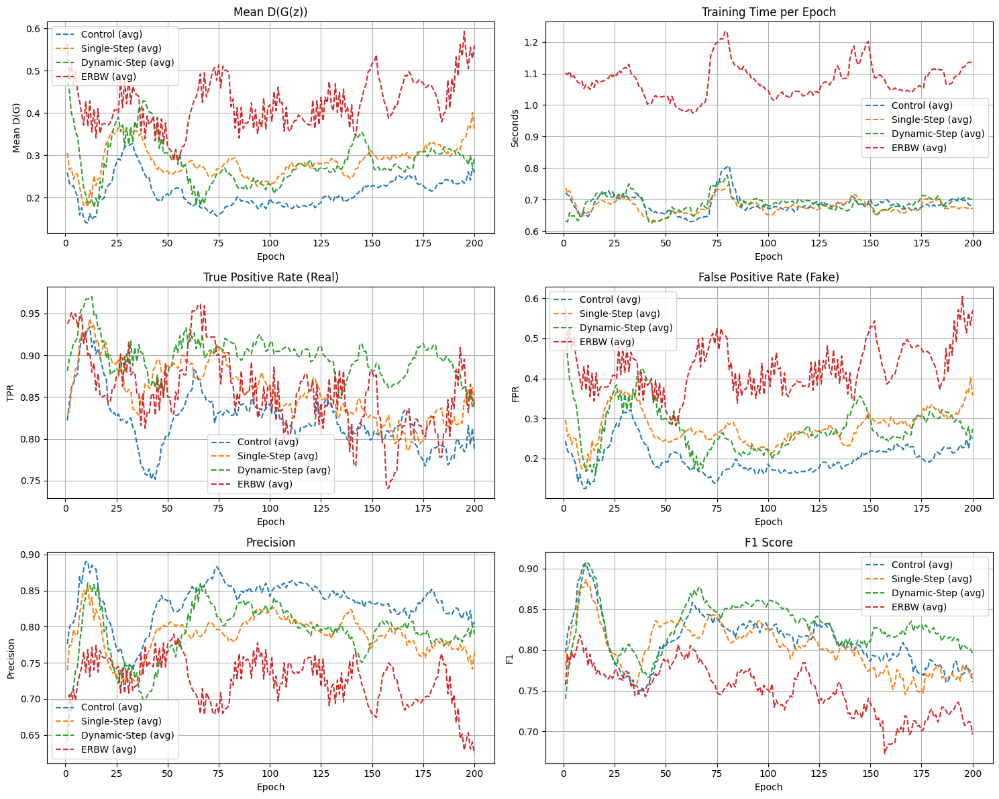

In [18]:
import pandas as pd
import matplotlib.pyplot as plt

# -------------------- Plot Summaries w/ Rolling Average (Distill) ------------------------
window_size = 10

# list of (metric_key, plot_title, ylabel)
metrics_to_plot = [
    ('mean_fake',  'Mean D(G(z))',                     'Mean D(G)'),
    ('time',       'Training Time per Epoch',          'Seconds'),
    ('tpr',        'True Positive Rate (Real)',        'TPR'),
    ('fpr',        'False Positive Rate (Fake)',       'FPR'),
    ('precision',  'Precision',                        'Precision'),
    ('f1',         'F1 Score',                         'F1'),
]

plt.figure(figsize=(15, 12))

for idx, (key, title, ylabel) in enumerate(metrics_to_plot, 1):
    ax = plt.subplot(3, 2, idx)
    for name in schemes:
        # raw series and its rolling‐mean
        raw    = pd.Series(metrics[name][key])
        smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
        ax.plot(epochs_list, smooth,
                linestyle='--', label=f"{name} (avg)")
    ax.set_title(title)
    ax.set_xlabel('Epoch')
    ax.set_ylabel(ylabel)
    ax.legend()
    ax.grid()

plt.tight_layout()
plt.show()


## Coevolve


Generation 1/200
Control: TPR=0.766, FPR=0.312, Precision=0.710, F1=0.737, MeanD(G)=0.321, Time=0.8s
Single-Step: TPR=0.797, FPR=0.484, Precision=0.622, F1=0.699, MeanD(G)=0.494, Time=0.9s
Dynamic-Step: TPR=0.812, FPR=0.594, Precision=0.578, F1=0.675, MeanD(G)=0.592, Time=1.1s
ERBW: TPR=0.875, FPR=0.766, Precision=0.533, F1=0.663, MeanD(G)=0.728, Time=1.9s

Generation 2/200
Control: TPR=0.891, FPR=0.047, Precision=0.950, F1=0.919, MeanD(G)=0.071, Time=1.2s
Single-Step: TPR=0.938, FPR=0.094, Precision=0.909, F1=0.923, MeanD(G)=0.113, Time=1.1s
Dynamic-Step: TPR=0.891, FPR=0.219, Precision=0.803, F1=0.844, MeanD(G)=0.216, Time=1.2s
ERBW: TPR=0.938, FPR=0.797, Precision=0.541, F1=0.686, MeanD(G)=0.807, Time=2.0s

Generation 3/200
Control: TPR=0.984, FPR=0.266, Precision=0.787, F1=0.875, MeanD(G)=0.242, Time=1.0s
Single-Step: TPR=0.969, FPR=0.203, Precision=0.827, F1=0.892, MeanD(G)=0.234, Time=1.9s
Dynamic-Step: TPR=1.000, FPR=0.297, Precision=0.771, F1=0.871, MeanD(G)=0.304, Time=0.9s
E

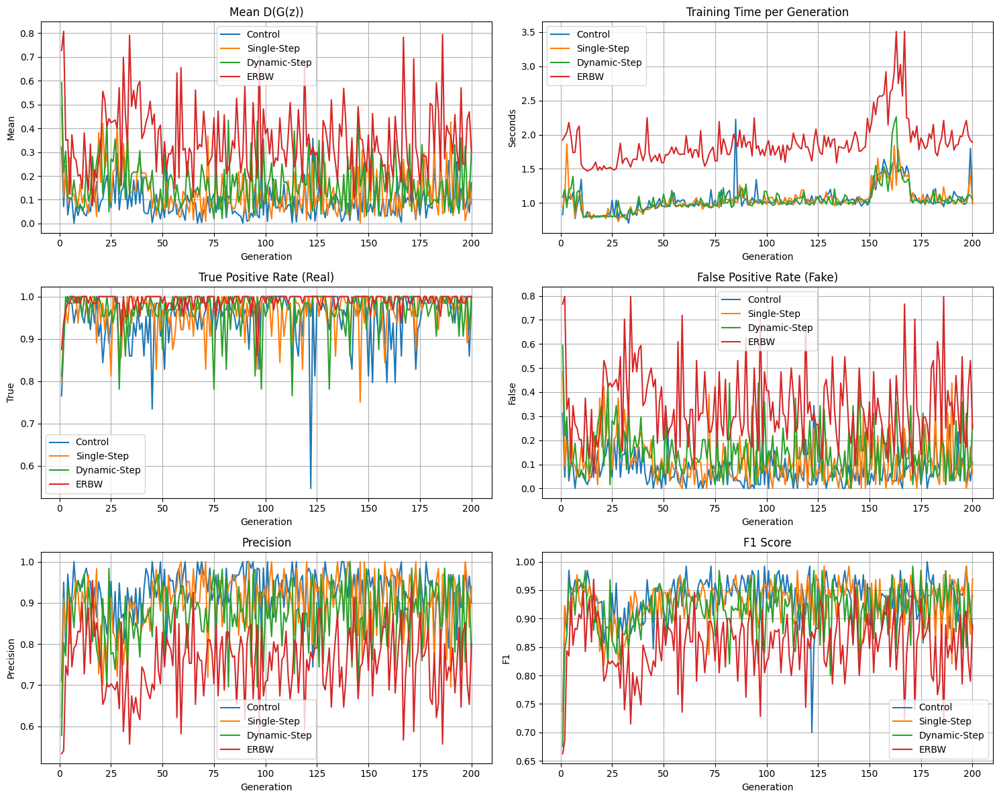

In [19]:
#!/usr/bin/env python3
"""
coevolve_real_vs_fake_schemes.py

Coevolution of pretrained DCGAN Generator & Discriminator on MNIST.
Implements four sampling schemes (Control, Single-Step, Dynamic-Step, ERBW),
starts from pretrained weights, alternates D and G training per generation,
tracks True Positive Rate (TPR) on real data, False Positive Rate (FPR) on fake data,
Precision and F1 for discriminator decisions, mean D(G(z)) on fake data, and training time,
saves model snapshots per generation, and plots final metrics.
"""
import os
import random
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.backends.cudnn as cudnn

import torchvision.datasets as dset
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np

from collections import OrderedDict
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import kurtosis

# ------------------- Config & Hyperparameters -------------------
# Use GPU if available, otherwise CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# Enable optimized GPU performance
cudnn.benchmark = True
# Seed for reproducibility
random.seed(2025)
torch.manual_seed(2025)

# DCGAN latent/sample dimensions
nz, ngf, ndf, nc = 100, 64, 64, 1
# Directory for saving and loading weights
weights_dir = './weights'
os.makedirs(weights_dir, exist_ok=True)

# Coevolution parameters
generations = 200     # number of alternating D/G cycles
D_steps    = 2         # discriminator updates per generation
G_steps    = 1         # generator updates per generation
batch_size = 64        # batch size for real & fake samples

# Parameter for Dynamic-Step scheme
target_kurtosis = 1.0

# --------------------- Model Definitions ---------------------
class Generator(nn.Module):
    """DCGAN Generator: maps noise z to an image."""
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False), nn.BatchNorm2d(ngf*8), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf*4), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False), nn.BatchNorm2d(ngf*2), nn.ReLU(True),
            nn.ConvTranspose2d(ngf*2, ngf,   4, 2, 1, bias=False), nn.BatchNorm2d(ngf),   nn.ReLU(True),
            nn.ConvTranspose2d(ngf,     nc,    1, 1, 0, bias=False), nn.Tanh()
        )

    def forward(self, z):
        """Forward pass: noise z → generated image."""
        return self.main(z)


class Discriminator(nn.Module):
    """DCGAN Discriminator: maps image to probability of realness."""
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc,    ndf,   4, 2, 1, bias=False), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf*2,   4, 2, 1, bias=False), nn.BatchNorm2d(ndf*2), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False), nn.BatchNorm2d(ndf*4), nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf*4,    1,   4, 1, 0, bias=False), nn.Sigmoid()
        )

    def forward(self, x):
        """Forward pass: image → scalar probability."""
        return self.main(x).view(-1)

# --------------------- Load pretrained -----------------------
# Initialize and load pretrained weights
netG0 = Generator().to(device)
netG0.load_state_dict(torch.load(os.path.join(weights_dir, 'netG_epoch_99.pth'), map_location=device))
netD0 = Discriminator().to(device)
netD0.load_state_dict(torch.load(os.path.join(weights_dir, 'netD_epoch_99.pth'), map_location=device))

# ----------------------- DataLoader --------------------------
# Load MNIST real images, normalized to [-1,1] for training
transform = transforms.Compose([
    transforms.Resize(32),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])
real_ds     = dset.MNIST('./data', train=True, download=True, transform=transform)
real_loader = torch.utils.data.DataLoader(real_ds, batch_size=batch_size, shuffle=True)

# Raw (unnormalized) images for ERBW similarity buffer
raw_transform = transforms.Compose([
    transforms.Resize(32),
    transforms.ToTensor()
])
raw_ds   = dset.MNIST('./data', train=True, download=True, transform=raw_transform)
raw_imgs = torch.stack([raw_ds[i][0] for i in range(len(raw_ds))]).to(device)

# ------------------ Sampling Schemes ------------------------
def train_control(G, D):
    """
    Control scheme:
    - Standard adversarial D & G updates with equal weighting.
    """
    optD = torch.optim.Adam(D.parameters(), lr=2e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss()

    # Discriminator updates
    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outR, outF = D(real), D(fake.detach())
        lossD = crit(outR, torch.ones_like(outR)) + crit(outF, torch.zeros_like(outF))
        optD.zero_grad(); lossD.backward(); optD.step()

    # Generator updates
    for _ in range(G_steps):
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        lossG = crit(D(fake), torch.ones(batch_size, device=device))
        optG.zero_grad(); lossG.backward(); optG.step()

    return G, D


def train_single_step(G, D, real_ratio=0.7):
    """
    Single-Step scheme:
    - Fixed real vs fake loss weighting in D updates.
    """
    optD = torch.optim.Adam(D.parameters(), lr=2e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')

    # Discriminator updates
    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outR, outF = D(real), D(fake.detach())
        wR, wF = real_ratio, 1-real_ratio
        lossD = (crit(outR, torch.ones_like(outR)) * wR).mean() + \
                (crit(outF, torch.zeros_like(outF)) * wF).mean()
        optD.zero_grad(); lossD.backward(); optD.step()

    # Generator updates
    for _ in range(G_steps):
        fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
        lossG = crit(D(fake2), torch.ones_like(outR)).mean()
        optG.zero_grad(); lossG.backward(); optG.step()

    return G, D


def train_dynamic_step(G, D, target_k=target_kurtosis):
    """
    Dynamic-Step scheme:
    - Adjust real vs fake weighting based on kurtosis of D(fake).
    """
    optD = torch.optim.Adam(D.parameters(), lr=2e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')

    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        outR, outF = D(real), D(fake.detach())
        k = kurtosis(outF.detach().cpu().numpy())
        ratio = np.clip(0.5 + 0.5 * abs(k - target_k), 0.2, 0.8)
        lossD = (crit(outR, torch.ones_like(outR)) * ratio).mean() + \
                (crit(outF, torch.zeros_like(outF)) * (1 - ratio)).mean()
        optD.zero_grad(); lossD.backward(); optD.step()

    for _ in range(G_steps):
        fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
        lossG = nn.BCELoss()(D(fake2), torch.ones_like(outR))
        optG.zero_grad(); lossG.backward(); optG.step()

    return G, D


class ERBWBuffer:
    """
    ERBW (Effortful Retrieval-Based Weighting) buffer:
    - Stores timestamps for each real sample, weights D(fake) loss by recency.
    """
    def __init__(self, data):
        self.data = data.view(len(data), -1).cpu().numpy()
        self.ts   = np.zeros(len(data))

    def update(self, fake):
        flat = fake.detach().view(len(fake), -1).cpu().numpy()
        idx  = np.argmax(cosine_similarity(flat, self.data), axis=1)
        self.ts[idx] = self.ts.max() + 1

    def weights(self, fake):
        flat = fake.detach().view(len(fake), -1).cpu().numpy()
        idx  = np.argmax(cosine_similarity(flat, self.data), axis=1)
        w    = F.softmax(torch.from_numpy(self.ts[idx]).float(), dim=0)
        return w.to(fake.device)


def train_erbw(G, D, buf):
    """
    ERBW sampling scheme for D updates.
    """
    optD = torch.optim.Adam(D.parameters(), lr=2e-4, betas=(0.5,0.999))
    optG = torch.optim.Adam(G.parameters(), lr=2e-4, betas=(0.5,0.999))
    crit = nn.BCELoss(reduction='none')

    for _ in range(D_steps):
        real = next(real_iter)[0].to(device)
        fake = G(torch.randn(batch_size, nz,1,1,device=device))
        buf.update(fake)
        w = buf.weights(fake)
        outR, outF = D(real), D(fake.detach())
        lossD = crit(outR, torch.ones_like(outR)).mean() * 0.5 + \
                (crit(outF, torch.zeros_like(outF)) * w).mean()
        optD.zero_grad(); lossD.backward(); optD.step()

    for _ in range(G_steps):
        fake2 = G(torch.randn(batch_size, nz,1,1,device=device))
        lossG = nn.BCELoss()(D(fake2), torch.ones_like(outR))
        optG.zero_grad(); lossG.backward(); optG.step()

    return G, D

# ------------------- Main Coevolution Loop -------------------
# Initialize ERBW buffer with raw images
buffer = ERBWBuffer(raw_imgs)
# Map scheme names to functions
schemes = OrderedDict([
    ('Control',      train_control),
    ('Single-Step',  train_single_step),
    ('Dynamic-Step', train_dynamic_step),
    ('ERBW',         lambda g,d: train_erbw(g, d, buffer))
])
# Initialize models for each scheme from pretrained weights
models = {}
for name in schemes:
    G = Generator().to(device)
    D = Discriminator().to(device)
    G.load_state_dict(netG0.state_dict())
    D.load_state_dict(netD0.state_dict())
    models[name] = {'G': G, 'D': D}

# Prepare metric storage
gens    = np.arange(1, generations+1)
metrics = { name: {'tpr': [], 'fpr': [], 'precision': [], 'f1': [], 'mean_fake': [], 'time': []}
            for name in schemes }

# Coevolution iterations
for gen in range(generations):
    print(f"\nGeneration {gen+1}/{generations}")
    # reset data iterator each generation
    real_iter = iter(real_loader)

    for name, fn in schemes.items():
        G, D = models[name]['G'], models[name]['D']
        start = time.time()
        G, D = fn(G, D)
        elapsed = time.time() - start

        # Evaluate on one real and one fake batch
        real_batch = next(real_iter)[0].to(device)
        fake_batch = G(torch.randn(batch_size, nz,1,1,device=device))
        with torch.no_grad():
            r = D(real_batch)
            f = D(fake_batch)

        # Compute binary classification metrics
        p_r = (r > 0.5).float()  # predictions on real
        p_f = (f > 0.5).float()  # predictions on fake (false positives)
        tp = p_r.sum().item()
        fp = p_f.sum().item()
        tpr = tp / batch_size
        fpr = fp / batch_size
        precision = tp / (tp + fp + 1e-8)
        f1 = 2 * precision * tpr / (precision + tpr + 1e-8)
        mean_fake = f.mean().item()

        # Log metrics
        metrics[name]['mean_fake'].append(mean_fake)
        metrics[name]['time'].append(elapsed)
        metrics[name]['tpr'].append(tpr)
        metrics[name]['fpr'].append(fpr)
        metrics[name]['precision'].append(precision)
        metrics[name]['f1'].append(f1)

        print(f"{name}: TPR={tpr:.3f}, FPR={fpr:.3f}, "
              f"Precision={precision:.3f}, F1={f1:.3f}, MeanD(G)={mean_fake:.3f}, Time={elapsed:.1f}s")

        # Save snapshot weights
        torch.save(D.state_dict(), os.path.join(weights_dir, f"D_coevolve_{name}_{gen+1}.pth"))
        torch.save(G.state_dict(), os.path.join(weights_dir, f"G_coevolve_{name}_{gen+1}.pth"))

# -------------------- Plot Summaries w/ Rolling Average ------------------------

import pandas as pd
import matplotlib.pyplot as plt

metrics_to_plot = [
    ('mean_fake',   'Mean D(G(z))'),
    ('time',        'Training Time per Generation'),
    ('tpr',         'True Positive Rate (Real)'),
    ('fpr',         'False Positive Rate (Fake)'),
    ('precision',   'Precision'),
    ('f1',          'F1 Score'),
]

plt.figure(figsize=(15, 12))

for idx, (key, title) in enumerate(metrics_to_plot, start=1):
    ax = plt.subplot(3, 2, idx)
    for name in schemes:
        raw    = pd.Series(metrics[name][key])
        ax.plot(gens, raw, label=f"{name}")
    ax.set_title(title)
    ax.set_xlabel('Generation')
    if key == 'time':
        ax.set_ylabel('Seconds')
    else:
        ax.set_ylabel(title.split(' ')[0])
    ax.legend()
    ax.grid()

plt.tight_layout()
plt.show()



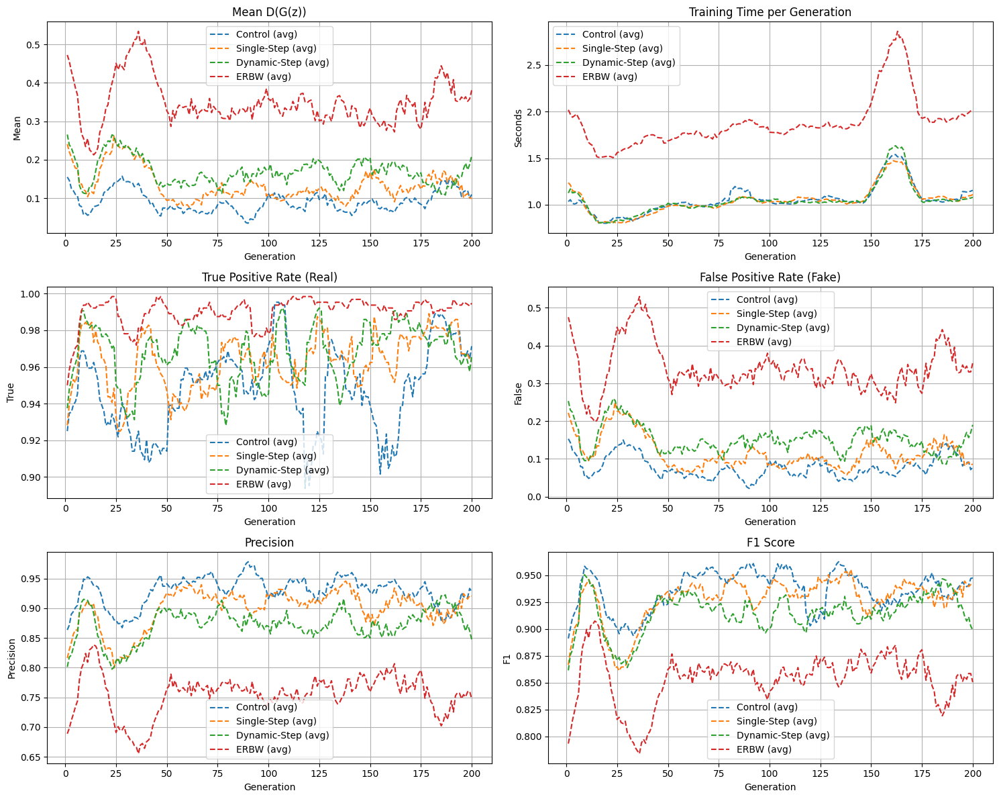

In [20]:
import pandas as pd
import matplotlib.pyplot as plt

# -------------------- Plot Summaries w/ Rolling Average ------------------------
window_size = 10
metrics_to_plot = [
    ('mean_fake',   'Mean D(G(z))'),
    ('time',        'Training Time per Generation'),
    ('tpr',         'True Positive Rate (Real)'),
    ('fpr',         'False Positive Rate (Fake)'),
    ('precision',   'Precision'),
    ('f1',          'F1 Score'),
]

plt.figure(figsize=(15, 12))

for idx, (key, title) in enumerate(metrics_to_plot, start=1):
    ax = plt.subplot(3, 2, idx)
    for name in schemes:
        raw    = pd.Series(metrics[name][key])
        smooth = raw.rolling(window=window_size, min_periods=1, center=True).mean()
        ax.plot(gens, smooth, linestyle='--', label=f"{name} (avg)")
    ax.set_title(title)
    ax.set_xlabel('Generation')
    if key == 'time':
        ax.set_ylabel('Seconds')
    else:
        ax.set_ylabel(title.split(' ')[0])
    ax.legend()
    ax.grid()

plt.tight_layout()
plt.show()


## Demo

Using saved weights from training, generate images for one epoch

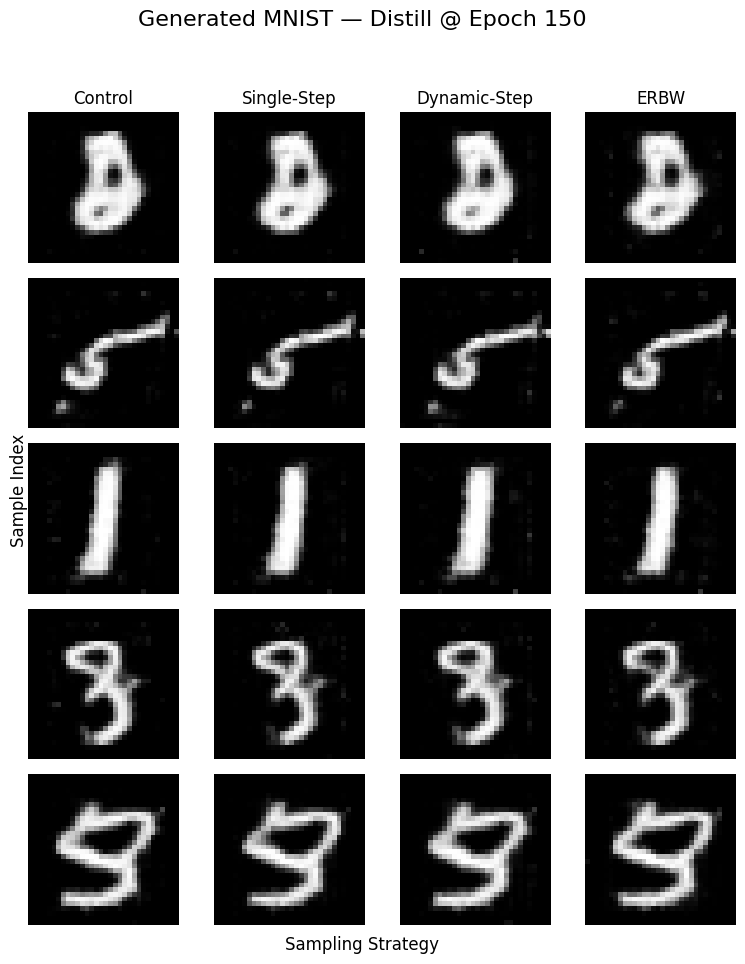

In [26]:
import os
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

# device & latent dim
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
nz = 100

# the four sampling strategies
STRATEGIES = ['Control', 'Single-Step', 'Dynamic-Step', 'ERBW']

# Generator architecture (must match your training scripts)
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, 64*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64*8), nn.ReLU(True),
            nn.ConvTranspose2d(64*8, 64*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*4), nn.ReLU(True),
            nn.ConvTranspose2d(64*4, 64*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*2), nn.ReLU(True),
            nn.ConvTranspose2d(64*2, 64,   4, 2, 1, bias=False),
            nn.BatchNorm2d(64),   nn.ReLU(True),
            nn.ConvTranspose2d(64,   1,    1, 1, 0, bias=False),
            nn.Tanh()
        )
    def forward(self, z):
        return self.main(z)

def load_generator(experiment, strategy, epoch, weights_dir='./weights'):
    """
    Load G_{experiment}_{strategy}_{epoch}.pth from weights_dir.
    experiment: 'distill' or 'coevolve'
    strategy: one of STRATEGIES
    """
    G = Generator().to(device)
    fname = f"G_{experiment}_{strategy}_{epoch}.pth"
    path = os.path.join(weights_dir, fname)
    if not os.path.isfile(path):
        raise FileNotFoundError(f"Cannot find {path}")
    G.load_state_dict(torch.load(path, map_location=device))
    G.eval()
    return G

def demo(experiment='distill', epoch=5, num_samples=5, weights_dir='./weights'):
    """
    Produce a num_samples × len(STRATEGIES) grid of generated digits.
    demo(experiment, epoch)
    """
    noise = torch.randn(num_samples, nz, 1, 1, device=device)
    fig, axes = plt.subplots(num_samples, len(STRATEGIES),
                             figsize=(len(STRATEGIES)*2, num_samples*2))

    for col, strat in enumerate(STRATEGIES):
        G = load_generator(experiment, strat, epoch, weights_dir)
        with torch.no_grad():
            fake_imgs = G(noise).cpu().squeeze().numpy()  # shape: [num_samples, 28,28]

        for row in range(num_samples):
            ax = axes[row, col]
            img = (fake_imgs[row] + 1.0) / 2.0  # denormalize from [-1,1] → [0,1]
            ax.imshow(img, cmap='gray', vmin=0, vmax=1)
            ax.axis('off')
            if col == 0:
                ax.set_ylabel(f"Sample {row+1}", fontsize=10)
        axes[0, col].set_title(strat, fontsize=12)

    fig.suptitle(f"Generated MNIST — {experiment.capitalize()} @ Epoch {epoch}", fontsize=16)
    fig.text(0.5, 0.04, 'Sampling Strategy', ha='center', fontsize=12)
    fig.text(0.06, 0.5, 'Sample Index', va='center', rotation='vertical', fontsize=12)
    plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])
    plt.show()

# Example call:
demo(experiment="distill", epoch=150)


View evolution across epochs as gif

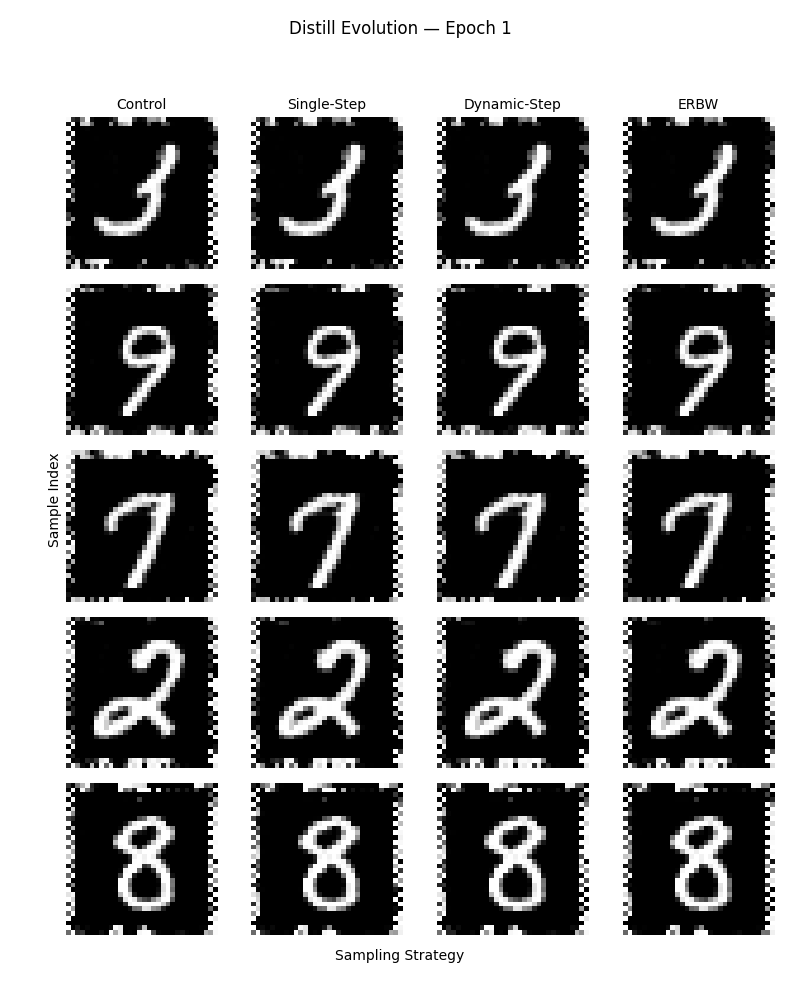

In [24]:
import imageio
import numpy as np
from IPython.display import Image, display
import matplotlib.pyplot as plt
import torch

def animate_epochs(experiment, epochs, num_samples=5, weights_dir='./weights',
                   fps=1, output_path='evolution.gif'):
    """
    For each epoch in `epochs`, load the 4 generators for that experiment,
    sample `num_samples` digits, assemble a grid, capture it, and
    write out an animated GIF evolving over time.
    Displays the GIF inline.
    """
    # fixed noise so we see the same latent vectors over time
    noise = torch.randn(num_samples, nz, 1, 1, device=device)
    frames = []

    for ep in epochs:
        # build the grid
        fig, axes = plt.subplots(num_samples, len(STRATEGIES),
                                 figsize=(len(STRATEGIES)*2, num_samples*2))
        for col, strat in enumerate(STRATEGIES):
            G = load_generator(experiment, strat, ep, weights_dir)
            with torch.no_grad():
                fake = G(noise).cpu().squeeze().numpy()  # (num_samples, H, W)

            for row in range(num_samples):
                ax = axes[row, col]
                img = (fake[row] + 1.0) / 2.0  # denormalize from [-1,1] to [0,1]
                ax.imshow(img, cmap='gray', vmin=0, vmax=1)
                ax.axis('off')
                if col == 0:
                    ax.set_ylabel(f"Sample {row+1}", fontsize=8)
            axes[0, col].set_title(strat, fontsize=10)

        fig.suptitle(f"{experiment.capitalize()} Evolution — Epoch {ep}", fontsize=12)
        fig.text(0.5, 0.04, 'Sampling Strategy', ha='center', fontsize=10)
        fig.text(0.06, 0.5, 'Sample Index', va='center', rotation='vertical', fontsize=10)
        plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])

        # render to buffer (RGBA) then convert to RGB
        buf, (w, h) = fig.canvas.print_to_buffer()
        arr = np.frombuffer(buf, dtype=np.uint8).reshape((h, w, 4))
        frames.append(arr[:, :, :3])
        plt.close(fig)

    # save and display
    imageio.mimsave(output_path, frames, fps=fps)
    display(Image(filename=output_path))
    return output_path

# Example usage in your notebook:
gif_path = animate_epochs(experiment='distill', epochs=range(1, 200), num_samples=5, fps=15)